# Prepare some things
## Load some modules

In [1]:
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from scipy.cluster import hierarchy
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import MinMaxScaler
import sklearn.metrics
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import sys
sys.path.append('../')
from clustering_metrics import evaluate_clustering
from draw_embeddings import draw_multiple_labels

In [3]:
# Disable warnings output (TSNE outputs one very time)
import warnings
warnings.filterwarnings('ignore')

# Load the data set

In [4]:
data_file = "../DO_NOT_PUBLISH/MetaboData_pseudoID.xlsx"
metabol = pd.read_excel(data_file, sheet_name="metabs", index_col=0).T
# Min-max normalization
metabol.iloc[:,:] = MinMaxScaler().fit_transform(metabol)
metabol.head()

,glycine,alanine,valine,leucine,isoleucine,serine,threonine,proline,arginine,glutamic,...,tcc,m_bu_p,mehp,x4_hpb,ibp,cibp,apap,apap_g,dcf,hctz
S000178_1,0.203059,0.111499,0.191536,0.250043,0.257227,0.298541,0.066532,0.136444,0.188422,0.174716,...,0.0,0.271801,0.266637,0.161973,0.0,0.0,0.018271,0.028760,0.296658,0.0
S000443_1,0.073279,0.115869,0.132288,0.149303,0.148693,0.084232,0.022798,0.092352,0.025114,0.074864,...,0.0,0.221467,0.197153,0.129863,0.0,0.0,0.009566,0.010220,0.199715,0.0
S000491_1,0.212805,0.304089,0.249373,0.263820,0.277999,0.385945,0.242866,0.262947,0.085272,0.116247,...,0.0,0.431987,0.480285,0.612164,0.0,0.0,0.030228,0.060776,0.349946,0.0
S000732_1,0.136319,0.715659,0.582759,0.654555,0.671802,0.386421,0.549783,0.517717,0.404796,0.199605,...,0.0,0.168995,0.150266,0.189479,0.0,0.0,0.001626,0.004522,0.348757,0.0
S000732_2,0.178756,0.387277,0.334169,0.344584,0.369569,0.187183,0.546836,0.228796,0.201617,0.165235,...,0.0,0.123065,0.164727,0.188603,0.0,0.0,0.081787,0.212806,0.369097,0.0


In [5]:
samples = pd.read_excel(data_file, sheet_name="samples", index_col=0)

# Drop the observations cointaining missing values:
drop_index = samples[samples['CVrisk3'].isna()].index
metabol.drop(drop_index, inplace=True, errors="ignore")
# Subset only the indeces present in the metabol data set
samples = samples.loc[metabol.index,:]

# Code gender as 0, 1
samples['gender'] = samples['gender'] -1
# Code CVrisk3 as 0, 1, 2
samples['CVrisk3'] = pd.Categorical(samples['CVrisk3'], categories=('Low','Med','Hig')).codes
# Convert time_origin to categorical type
samples['time_origin'] = pd.Categorical(samples['time_origin'], categories=('baseline','six','twelve'))

samples.head()

,X.SampleID,KKHNGID,time_origin,gender,pred_risk,CVrisk3,AGE,SCBIA1,SCANT2,SCBIA4,TG,HDL,LDL,CHO,HBA1CPC,SCBP1,SCBP2,HSCRP,CR
S000178_1,S000178_1,20161,baseline,0,0.020379,2,51,22.52,90.0,10.15,1.13,1.68,4.94,6.87,5.1,125,90,0.71,77.0
S000443_1,S000443_1,3557,baseline,1,0.000580,0,41,23.06,96.8,33.33,1.30,1.68,2.78,4.29,5.5,113,78,0.32,63.0
S000491_1,S000491_1,1783,baseline,1,0.001671,1,47,22.15,92.3,30.20,0.90,1.46,2.80,4.69,5.3,117,82,0.78,65.0
S000732_1,S000732_1,104735,baseline,1,0.000308,0,38,22.90,87.6,30.42,1.38,1.94,1.56,3.54,5.2,109,83,2.86,70.0
S000732_2,S000732_2,104735,six,1,0.000398,0,39,23.34,102.5,31.41,1.10,1.86,1.65,3.82,4.9,117,83,2.13,78.0


In [6]:
print("Number of observations:", metabol.shape[0])
print("Number of variables:", metabol.shape[1])
print("Number of data points:", np.multiply(*metabol.shape))

Number of observations: 1020
Number of variables: 411
Number of data points: 419220


# Raw data

In [7]:
def clusters_by_individual(samples, labels):
    """
    Computes the corrected ratio of individuals that where assigned only one cluster.
    Groups the observations by individual,
    if all the observations in the group have been assigned to the same cluster,   
    corrects for the probabilty of each cluster
    and the number of observations in the group.
    """
    labels = pd.Series(labels)
    df = pd.DataFrame({"id":[i[:-2] for i in samples.index],
                       "label": labels})
    ratio = 0
    for i in set(df.id):
        clusters = df.label[df.id==i]
        if len(set(clusters)) == 1:
            prob_cluster = labels.value_counts()[list(set(clusters))[0]] / len(labels)
            ratio_num_obs = len(clusters)/len(df.id)
            ratio += 1 * prob_cluster * ratio_num_obs
    return(ratio)


def compute_metrics(rl_method, clust_method, n_clusters, var_name, data, labels, clusters, samples):
    """
    Computes Accuracy, ARI, AMI, silhouette
    and ratio of individuals that where assigned only one cluster.
    Prints them nicely and returns a dictionary.
    """
    metrics = evaluate_clustering(data, labels, clusters, False)
    ratio = clusters_by_individual(samples, clusters)
    print(name,
          [f'{metric}: {value:.3f}' for metric, value in metrics.items()],
          f'[Same clust.: {ratio:.3f}]')
    results = {"rl_method": rl_method, 
               "clust_method": clust_method, 
               "n_clusters": n_clusters, 
               "variable": var_name,
               "same_clust": ratio}
    results.update(metrics)
    return results

In [8]:
rl_method = "Raw data"

tsne = TSNE(n_components=2, init='pca')
metabol_raw_tsne = tsne.fit_transform(metabol)

data = metabol
tsne_data = metabol_raw_tsne

cluster_numbers = (2, 3)
true_labels = {'gender': samples['gender'],
               'cv_risk': samples['CVrisk3']}
cluster_labels = []
results = []

## K-means

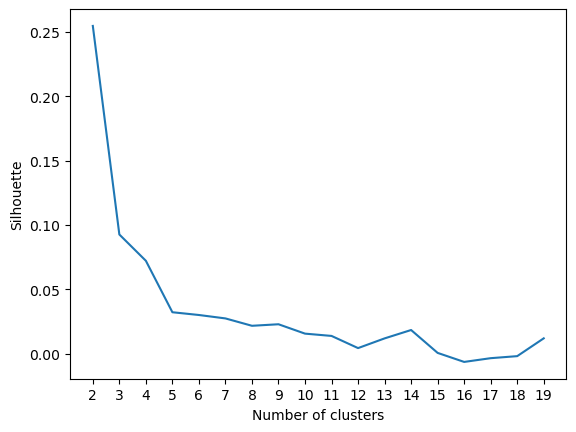

In [10]:
MIN_K = 2
MAX_K = 20

ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    kmeans = KMeans(n_clusters=k, n_init=30)
    labels = kmeans.fit_predict(data)
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.548', 'ARI: 0.000', 'AMI: 0.000', 'Sil: 0.255'] [Same clust.: 0.474]
cv_risk ['Acc: 0.359', 'ARI: 0.001', 'AMI: 0.000', 'Sil: 0.093'] [Same clust.: 0.207]


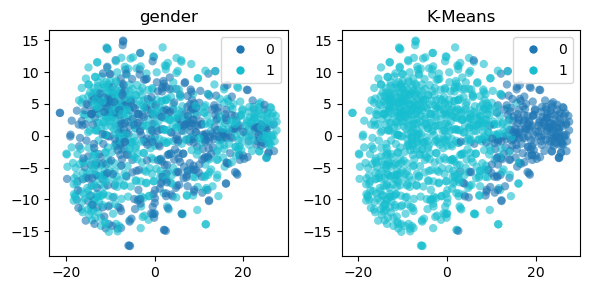

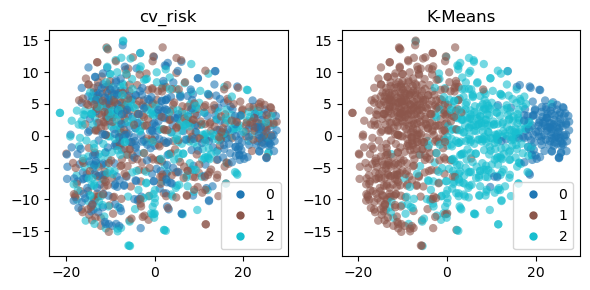

In [9]:
clust_method = "K-Means"

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    kmeans = KMeans(n_clusters=k, n_init=30)
    cluster_labels_ = kmeans.fit_predict(data)
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

## GMM

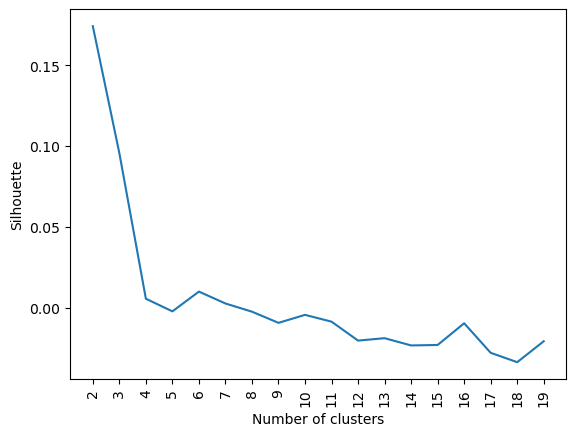

In [12]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    gmm = GaussianMixture(n_components=k, covariance_type='diag', n_init=30)
    labels = gmm.fit_predict(data)
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks, rotation=90)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.548', 'ARI: 0.000', 'AMI: 0.000', 'Sil: 0.174'] [Same clust.: 0.327]
cv_risk ['Acc: 0.356', 'ARI: 0.001', 'AMI: -0.000', 'Sil: 0.096'] [Same clust.: 0.167]


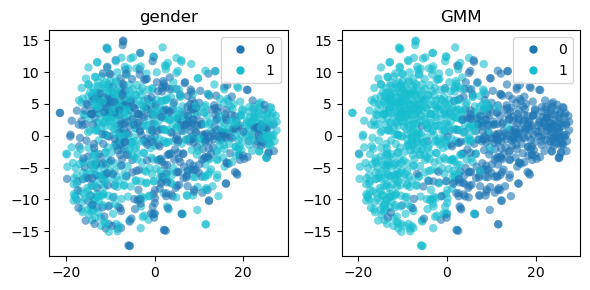

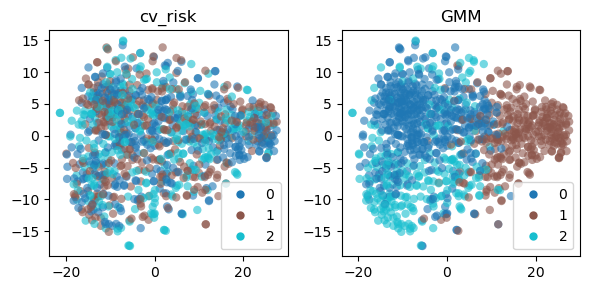

In [12]:
clust_method = "GMM"

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    gmm = GaussianMixture(n_components=k, covariance_type='diag', n_init=30)
    cluster_labels_ = gmm.fit_predict(data)
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

## Agglomerative

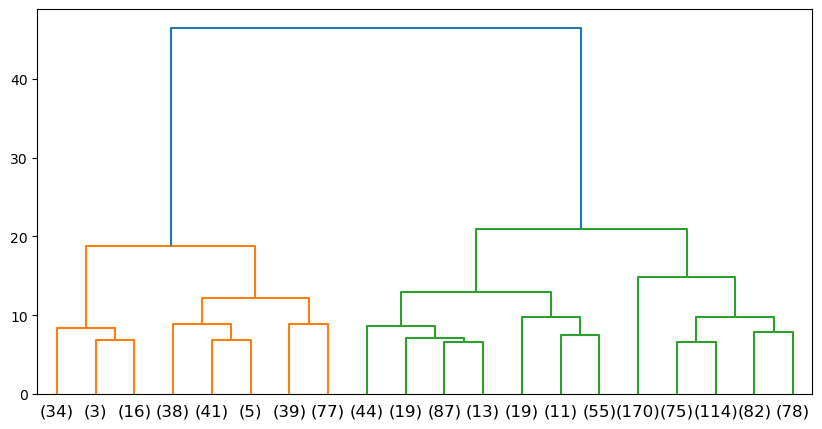

In [13]:
hier = hierarchy.linkage(data, method='ward', metric="euclidean")

plt.figure(figsize=(10, 5))
hierarchy.dendrogram(Z=hier, p=20, truncate_mode='lastp')
plt.show()

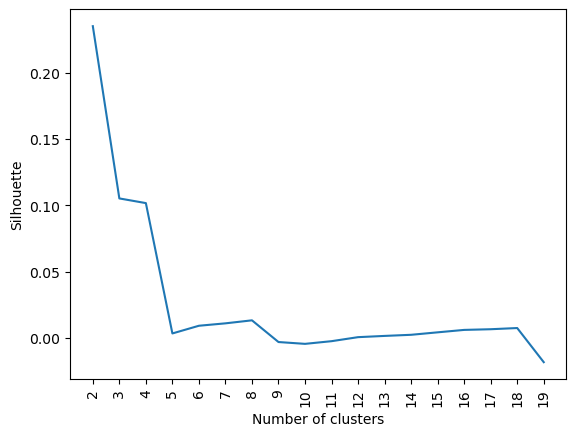

In [15]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    labels = hierarchy.cut_tree(hier, n_clusters=k).squeeze()
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks, rotation=90)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.548', 'ARI: 0.000', 'AMI: 0.000', 'Sil: 0.235'] [Same clust.: 0.463]
cv_risk ['Acc: 0.356', 'ARI: -0.001', 'AMI: 0.000', 'Sil: 0.105'] [Same clust.: 0.178]


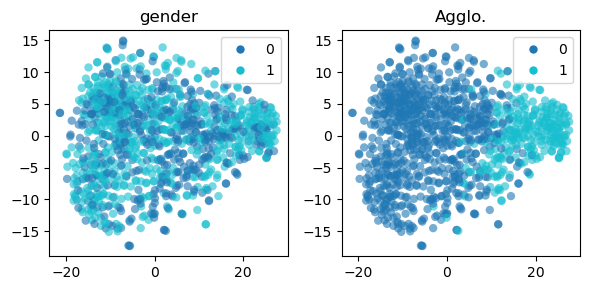

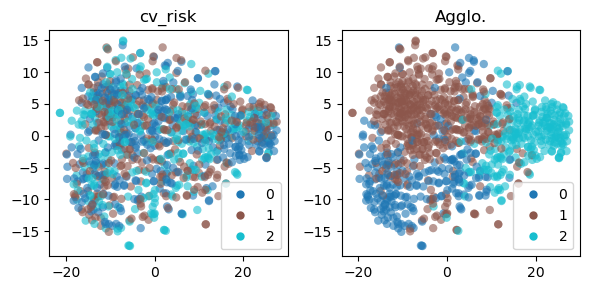

In [14]:
clust_method = "Agglo."

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    cluster_labels_ = hierarchy.cut_tree(hier, n_clusters=k).squeeze()
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

# PCA

In [15]:
# Find the number of PCs to explain 0.8 of the variance:
pca = PCA(n_components=0.8)
metabol_pca = pca.fit_transform(metabol)

# Number of PCs:
pca.n_components_

86

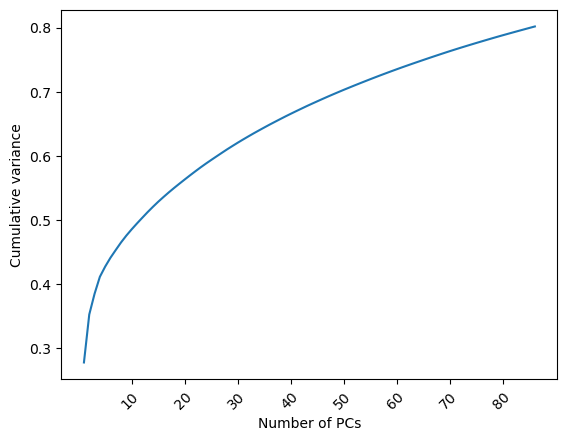

In [16]:
plt.plot(np.arange(0, pca.n_components_), np.cumsum(pca.explained_variance_ratio_))
plt.xticks(np.arange(9, pca.n_components_, 10), np.arange(10, pca.n_components_+1, 10), rotation=45, rotation_mode="anchor", ha='right')
plt.xlabel('Number of PCs')
plt.ylabel('Cumulative variance');
plt.show()

## K-means

In [17]:
rl_method = "PCA"

tsne = TSNE(n_components=2, init='pca')
metabol_pca_tsne = tsne.fit_transform(metabol_pca)

data = metabol_pca
tsne_data = metabol_pca_tsne

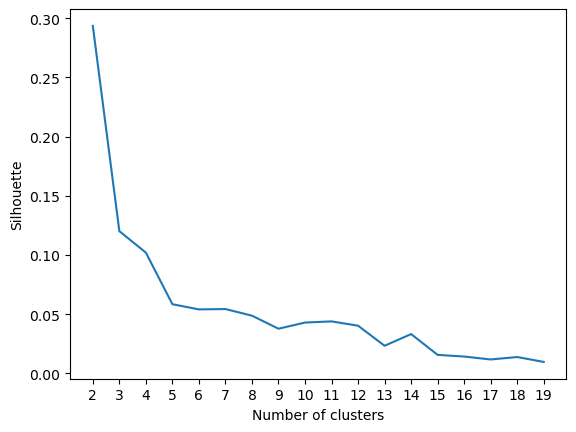

In [20]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    kmeans = KMeans(n_clusters=k, n_init=30)
    labels = kmeans.fit_predict(data)
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.548', 'ARI: 0.000', 'AMI: 0.000', 'Sil: 0.294'] [Same clust.: 0.474]
cv_risk ['Acc: 0.361', 'ARI: 0.001', 'AMI: 0.000', 'Sil: 0.120'] [Same clust.: 0.201]


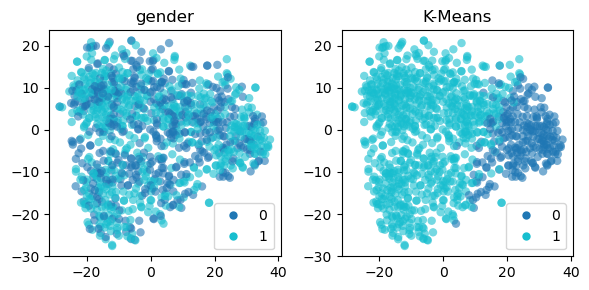

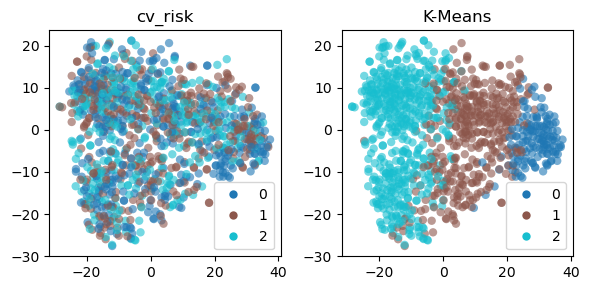

In [18]:
clust_method = "K-Means"

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    kmeans = KMeans(n_clusters=k, n_init=30)
    cluster_labels_ = kmeans.fit_predict(data)
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

## GMM

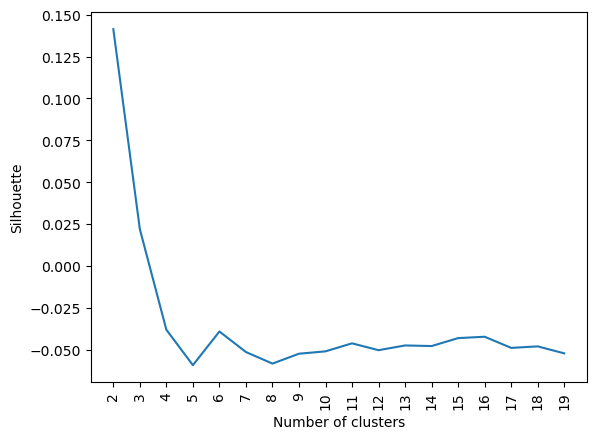

In [22]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    gmm = GaussianMixture(n_components=k, covariance_type='diag', n_init=30)
    labels = gmm.fit_predict(data)
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks, rotation=90)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.552', 'ARI: 0.010', 'AMI: 0.009', 'Sil: 0.141'] [Same clust.: 0.245]
cv_risk ['Acc: 0.372', 'ARI: 0.002', 'AMI: 0.002', 'Sil: 0.022'] [Same clust.: 0.123]


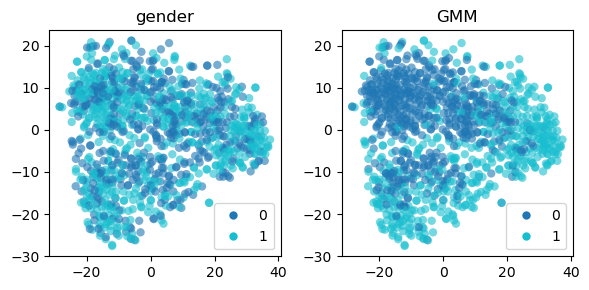

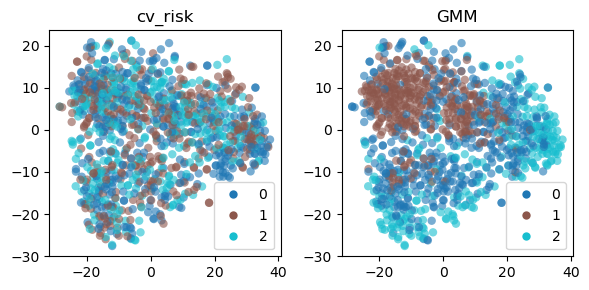

In [19]:
clust_method = "GMM"

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    gmm = GaussianMixture(n_components=k, covariance_type='diag', n_init=30)
    cluster_labels_ = gmm.fit_predict(data)
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))
    
    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

## Agglomerative

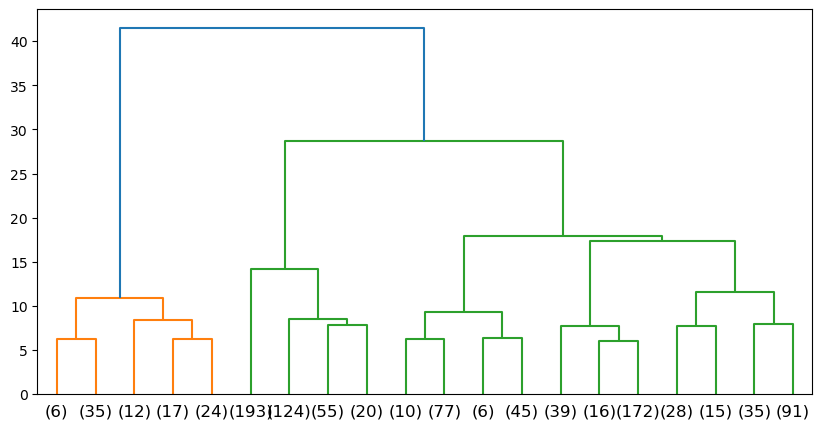

In [20]:
hier = hierarchy.linkage(data, method='ward', metric="euclidean")

plt.figure(figsize=(10, 5))
hierarchy.dendrogram(Z=hier, p=20, truncate_mode='lastp')
plt.show()

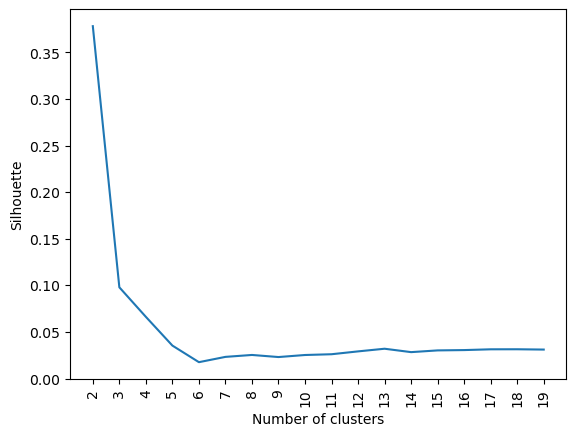

In [25]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    labels = hierarchy.cut_tree(hier, n_clusters=k).squeeze()
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks, rotation=90)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.548', 'ARI: 0.000', 'AMI: 0.000', 'Sil: 0.378'] [Same clust.: 0.748]
cv_risk ['Acc: 0.353', 'ARI: 0.001', 'AMI: -0.000', 'Sil: 0.098'] [Same clust.: 0.236]


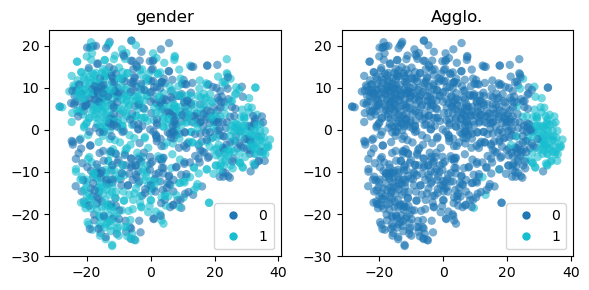

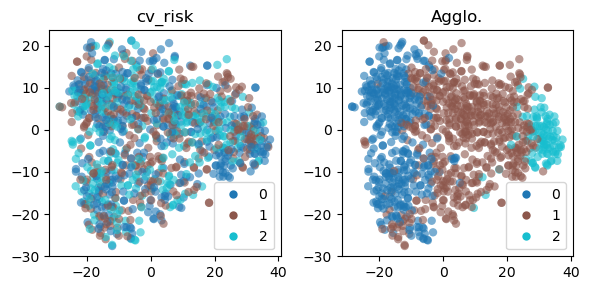

In [21]:
clust_method = "Agglo."

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    cluster_labels_ = hierarchy.cut_tree(hier, n_clusters=k).squeeze()
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

# Feature selection + PCA

I'll keep only the variables whith a standard deviation higher than the mean.

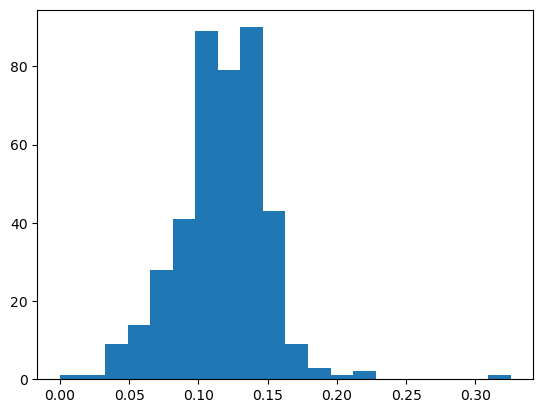

In [22]:
plt.hist(metabol.std(), bins=20)
plt.show()

In [23]:
print("Num. variables before:", metabol.shape[1])
keep_vars = metabol.std() > metabol.std().mean()
metabol_featsel = metabol.loc[:,keep_vars]
print("Num. variables after:", metabol_featsel.shape[1])

Num. variables before: 411
Num. variables after: 214


In [24]:
# Find the number of PCs to explain 0.8 of the variance:
pca = PCA(n_components=0.8)
metabol_featsel_pca = pca.fit_transform(metabol_featsel)

# Number of PCs:
pca.n_components_

50

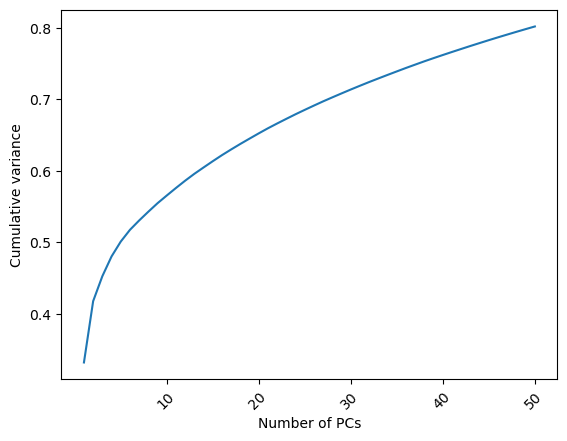

In [25]:
plt.plot(np.arange(0, pca.n_components_), np.cumsum(pca.explained_variance_ratio_))
plt.xticks(np.arange(9, pca.n_components_, 10), np.arange(10, pca.n_components_+1, 10), rotation=45, rotation_mode="anchor", ha='right')
plt.xlabel('Number of PCs')
plt.ylabel('Cumulative variance');
plt.show()

## K-means

In [26]:
rl_method = "FeatSel + PCA"

tsne = TSNE(n_components=2, init='pca')
metabol_featsel_pca_tsne = tsne.fit_transform(metabol_featsel_pca)

data = metabol_featsel_pca
tsne_data = metabol_featsel_pca_tsne

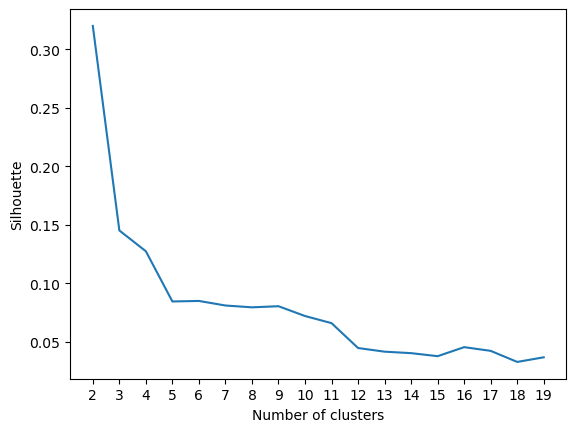

In [32]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    kmeans = KMeans(n_clusters=k, n_init=30)
    labels = kmeans.fit_predict(data)
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.548', 'ARI: 0.000', 'AMI: 0.000', 'Sil: 0.320'] [Same clust.: 0.477]
cv_risk ['Acc: 0.356', 'ARI: 0.001', 'AMI: 0.000', 'Sil: 0.145'] [Same clust.: 0.204]


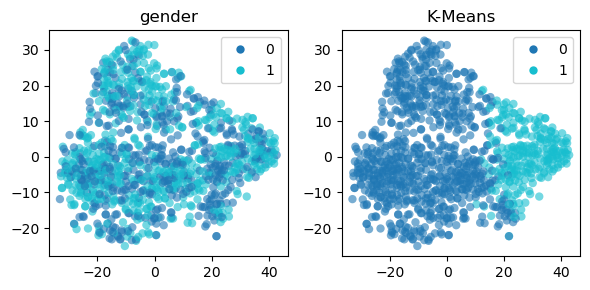

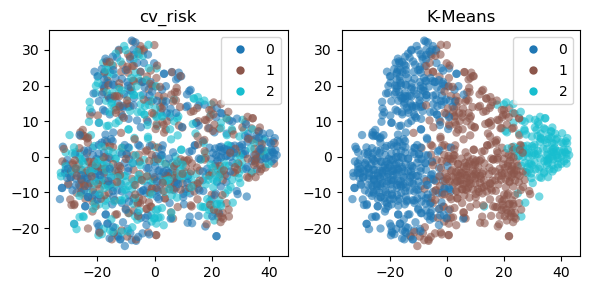

In [27]:
clust_method = "K-Means"

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    kmeans = KMeans(n_clusters=k, n_init=30)
    cluster_labels_ = kmeans.fit_predict(data)
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

## GMM

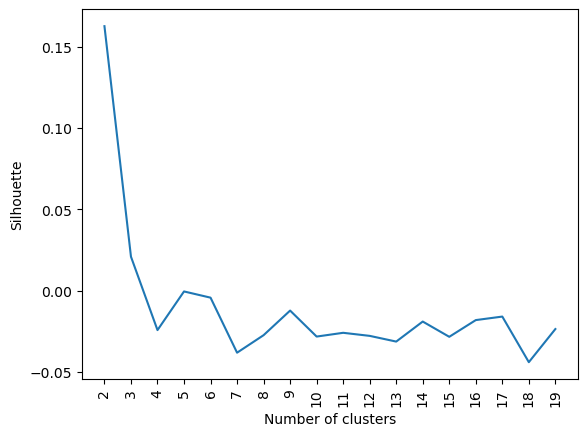

In [34]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    gmm = GaussianMixture(n_components=k, covariance_type='diag', n_init=30)
    labels = gmm.fit_predict(data)
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks, rotation=90)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.555', 'ARI: 0.011', 'AMI: 0.011', 'Sil: 0.163'] [Same clust.: 0.251]
cv_risk ['Acc: 0.357', 'ARI: 0.001', 'AMI: 0.000', 'Sil: 0.021'] [Same clust.: 0.135]


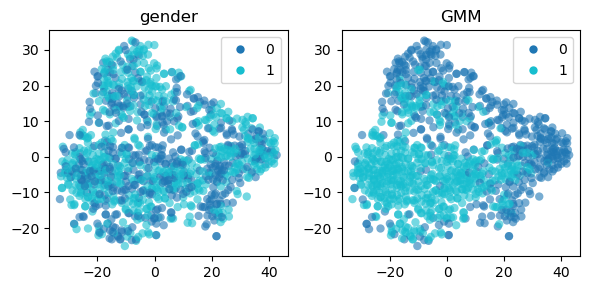

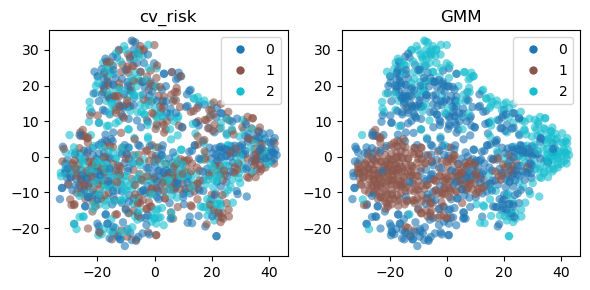

In [28]:
clust_method = "GMM"

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    gmm = GaussianMixture(n_components=k, covariance_type='diag', n_init=30)
    cluster_labels_ = gmm.fit_predict(data)
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

## Agglomerative

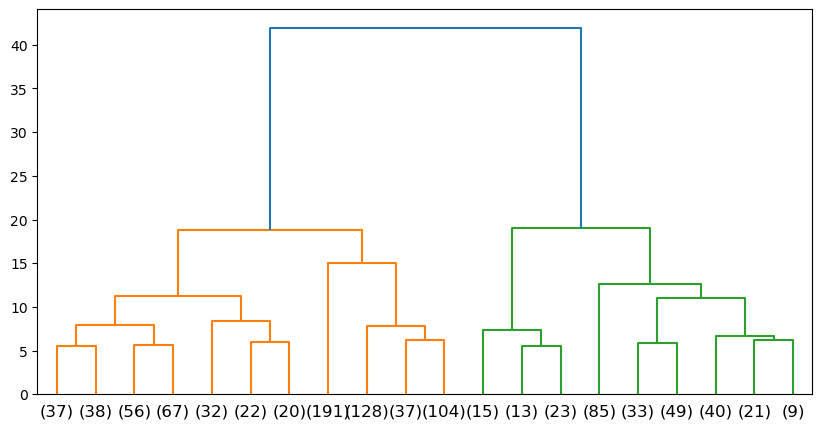

In [29]:
hier = hierarchy.linkage(data, method='ward', metric="euclidean")

plt.figure(figsize=(10, 5))
hierarchy.dendrogram(Z=hier, p=20, truncate_mode='lastp')
plt.show()

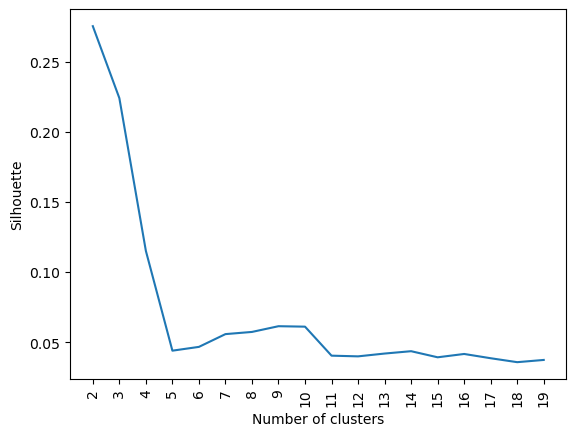

In [37]:
ks = np.arange(MIN_K, MAX_K)
sils = []
for k in ks:
    labels = hierarchy.cut_tree(hier, n_clusters=k).squeeze()
    sils.append(sklearn.metrics.silhouette_score(data, labels))

plt.plot(sils)
plt.xticks(np.arange(0, len(ks)), ks, rotation=90)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette');

gender ['Acc: 0.548', 'ARI: 0.000', 'AMI: 0.000', 'Sil: 0.275'] [Same clust.: 0.406]
cv_risk ['Acc: 0.360', 'ARI: -0.000', 'AMI: 0.001', 'Sil: 0.224'] [Same clust.: 0.393]


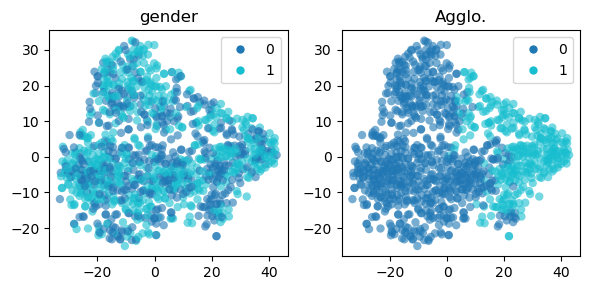

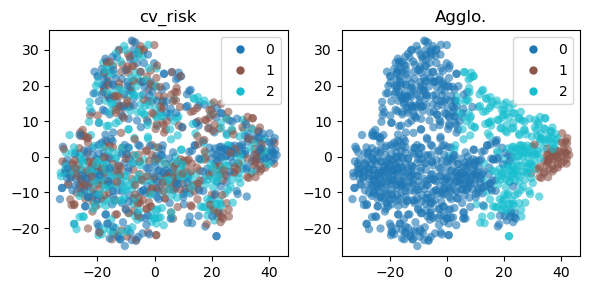

In [30]:
clust_method = "Agglo."

for k, (name, labels) in zip (cluster_numbers, true_labels.items()):
    # Compute cluster assignments
    cluster_labels_ = hierarchy.cut_tree(hier, n_clusters=k).squeeze()
    cluster_labels.append({"rl_method": rl_method, 
                           "clust_method": clust_method, 
                           "n_clusters": k, 
                           "labels": cluster_labels_})

    # Compute metrics
    results.append(compute_metrics(rl_method, clust_method, k, name, data, labels, cluster_labels_, samples))

    # Draw scatterplots
    show_labels = {name: labels.to_numpy(),
                   clust_method: cluster_labels_}
    draw_multiple_labels(tsne_data, show_labels, subplot_size=(3,3), alpha=0.6)

# Results

## Metrics

In [31]:
results = pd.DataFrame(results)
# Save the ametrics on a CSV file
results.to_csv("results/metrics_classic.csv", index=False)

results_mean = results.set_index(["rl_method","clust_method"]).groupby(level=[0,1]).mean()
results_mean = results_mean.iloc[:,1:]
metrics=['same_clust','Acc','ARI','AMI','Sil']
results_mean.style.background_gradient(axis=0, cmap="cividis", text_color_threshold=0.3, subset=metrics).format('{:.2f}', subset=metrics)

In [32]:
results.style.background_gradient(axis=0, cmap="cividis", text_color_threshold=0.3, subset=metrics).format('{:.2f}', subset=metrics)

,rl_method,clust_method,n_clusters,variable,same_clust,Acc,ARI,AMI,Sil
0,Raw data,K-Means,2,gender,0.47,0.55,0.00,0.00,0.25
1,Raw data,K-Means,3,cv_risk,0.21,0.36,0.00,0.00,0.09
2,Raw data,GMM,2,gender,0.33,0.55,0.00,0.00,0.17
3,Raw data,GMM,3,cv_risk,0.17,0.36,0.00,-0.00,0.10
4,Raw data,Agglo.,2,gender,0.46,0.55,0.00,0.00,0.24
5,Raw data,Agglo.,3,cv_risk,0.18,0.36,-0.00,0.00,0.11
6,PCA,K-Means,2,gender,0.47,0.55,0.00,0.00,0.29
7,PCA,K-Means,3,cv_risk,0.20,0.36,0.00,0.00,0.12
8,PCA,GMM,2,gender,0.24,0.55,0.01,0.01,0.14
9,PCA,GMM,3,cv_risk,0.12,0.37,0.00,0.00,0.02


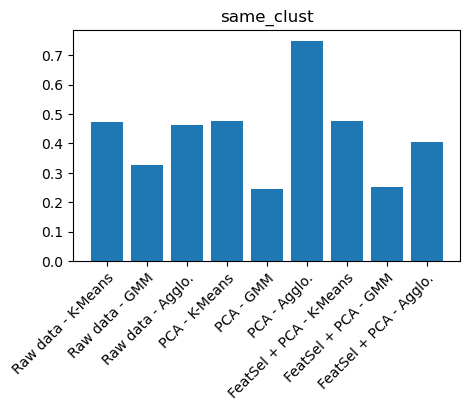

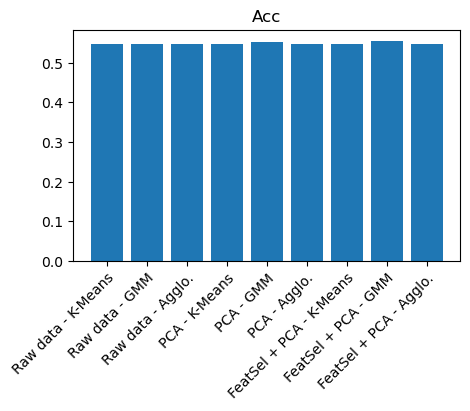

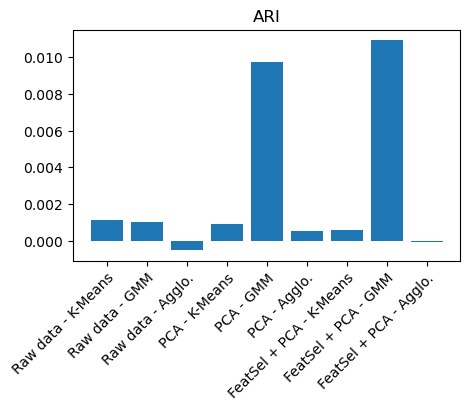

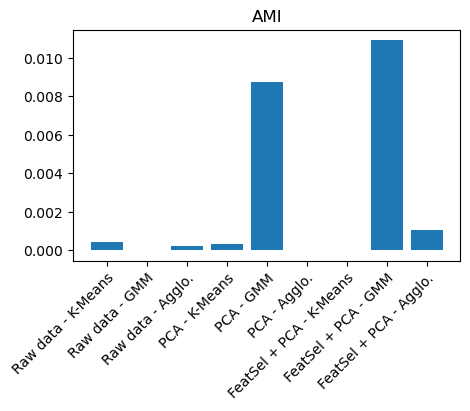

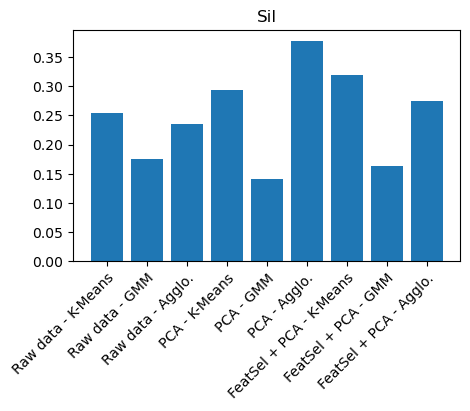

In [33]:
labels = (results.rl_method + " - " + results.clust_method)

for metric in (results.same_clust, results.Acc, results.ARI, results.AMI, results.Sil):
    plt.subplots(figsize=(5,3))
    plt.bar(labels, metric)
    plt.title(metric.name)
    plt.xticks(rotation=45, rotation_mode="anchor", ha='right')
    plt.show()

It doesn't seem that there is much agreement between the clusters assignments and the true categorical classes.
But some of the methods achieve assigning the same cluster to all the samples of the same individual.

## Compare assignments

In [34]:
labels = pd.DataFrame([d['labels'] for d in cluster_labels])
methods = pd.DataFrame(cluster_labels).loc[:,('rl_method', 'clust_method', 'n_clusters')]
cluster_labels_df = pd.concat((methods, labels), axis=1)

# Save the assignments on a CSV file
pd.DataFrame(cluster_labels_df).to_csv("results/assign_classic.csv", index=False)

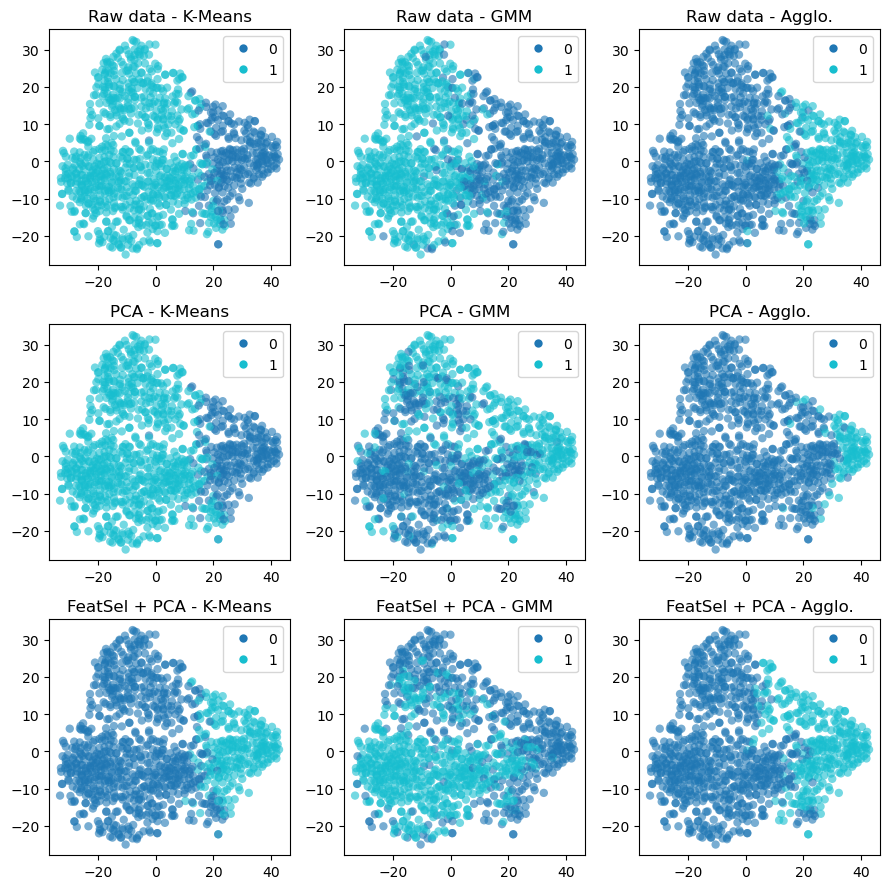

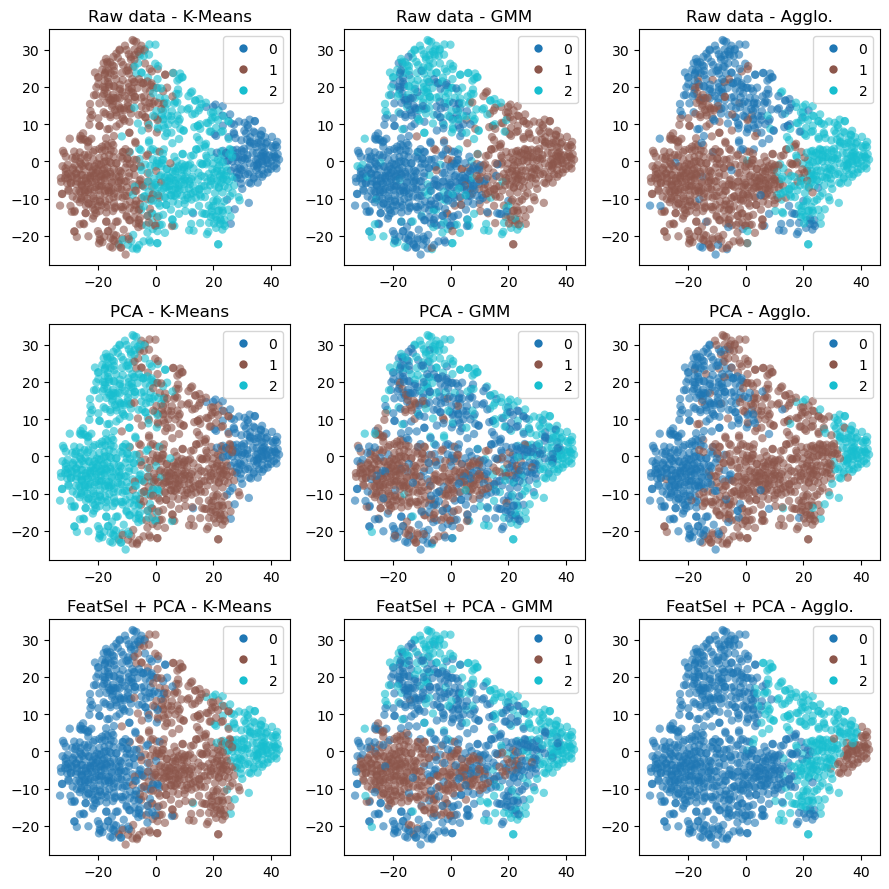

In [35]:
for k in cluster_numbers:
    clusters = cluster_labels_df[cluster_labels_df.n_clusters==k]
    show_labels = {clusters.rl_method[i] + " - " + clusters.clust_method[i]: clusters.loc[i,0:] for i in clusters.index}
    draw_multiple_labels(tsne_data, show_labels, max_cols=3, subplot_size=(3,3), alpha=0.6)

The cluster assignments shows some overlapping, both between 2 and 3 groups, and between the different methods.

## Clusters vs health indicators

Finally, I'll plot the health indicators and color some of the cluster assignments
that seem representative of the results.
If there were a clear relation between the clusters and some of the variables,
It should be easy to detect it on the plots.

In [36]:
cluster_labels_df.iloc[:,:3]

,rl_method,clust_method,n_clusters
0,Raw data,K-Means,2
1,Raw data,K-Means,3
2,Raw data,GMM,2
3,Raw data,GMM,2
4,Raw data,GMM,3
5,Raw data,Agglo.,2
6,Raw data,Agglo.,3
7,PCA,K-Means,2
8,PCA,K-Means,3
9,PCA,GMM,2


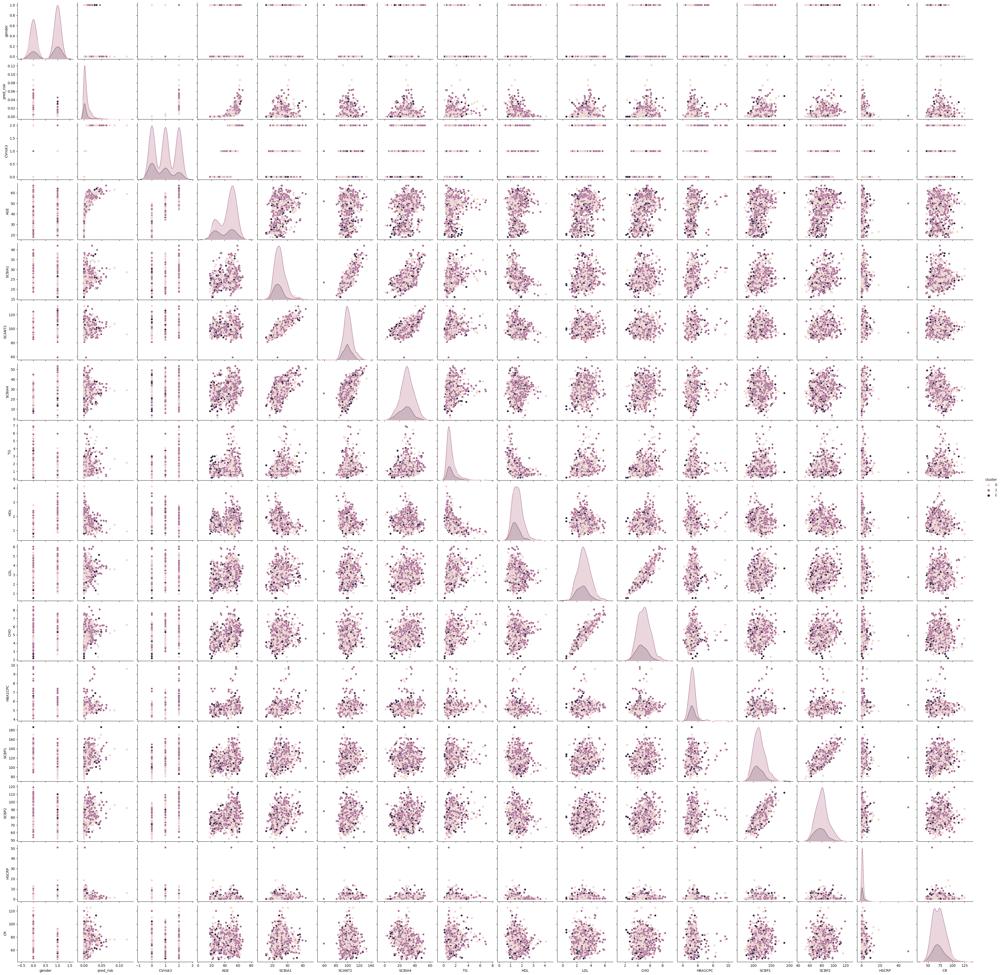

In [45]:
# Featsel + PCA - K-Means, K = 3
samples['cluster'] = list(cluster_labels_df.loc[13,0:])
sns.pairplot(samples.iloc[:,3:], hue='cluster')
plt.show()

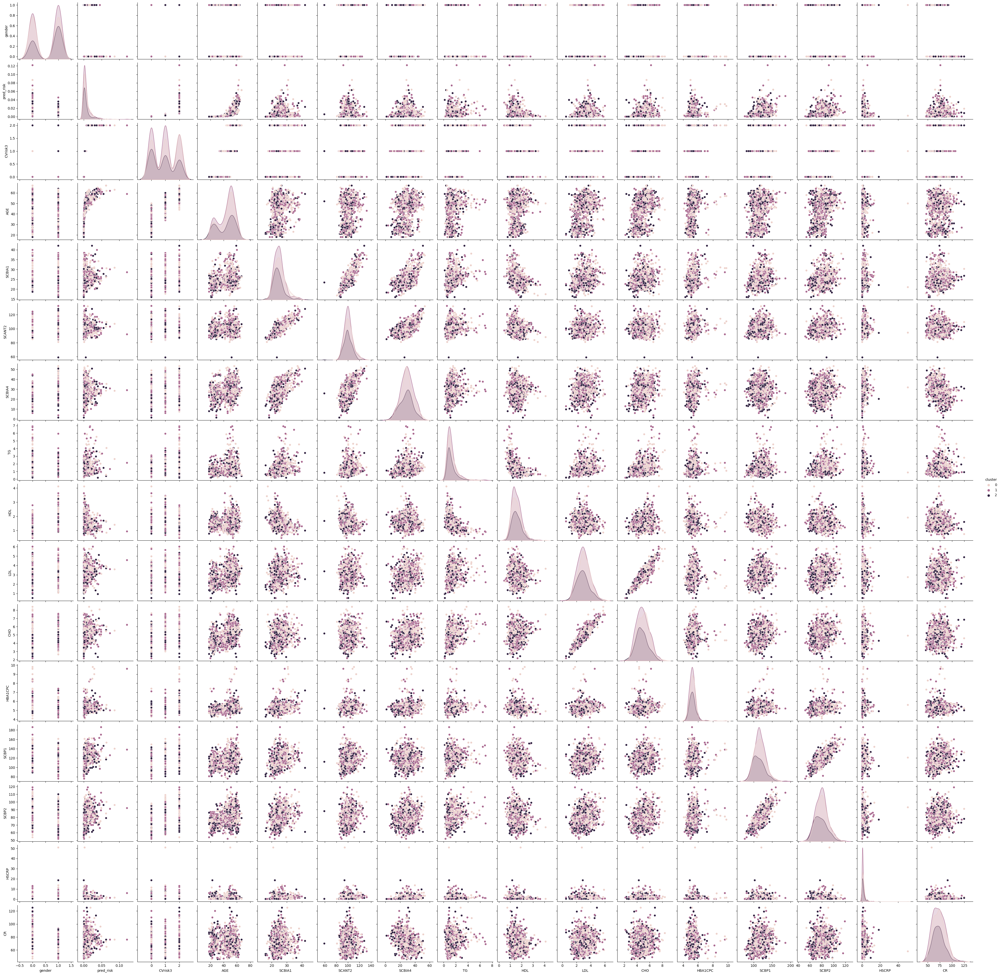

In [46]:
# PCA - GMM, K = 3
samples['cluster'] = list(cluster_labels_df.loc[9,0:])
sns.pairplot(samples.iloc[:,3:], hue='cluster')
plt.show()

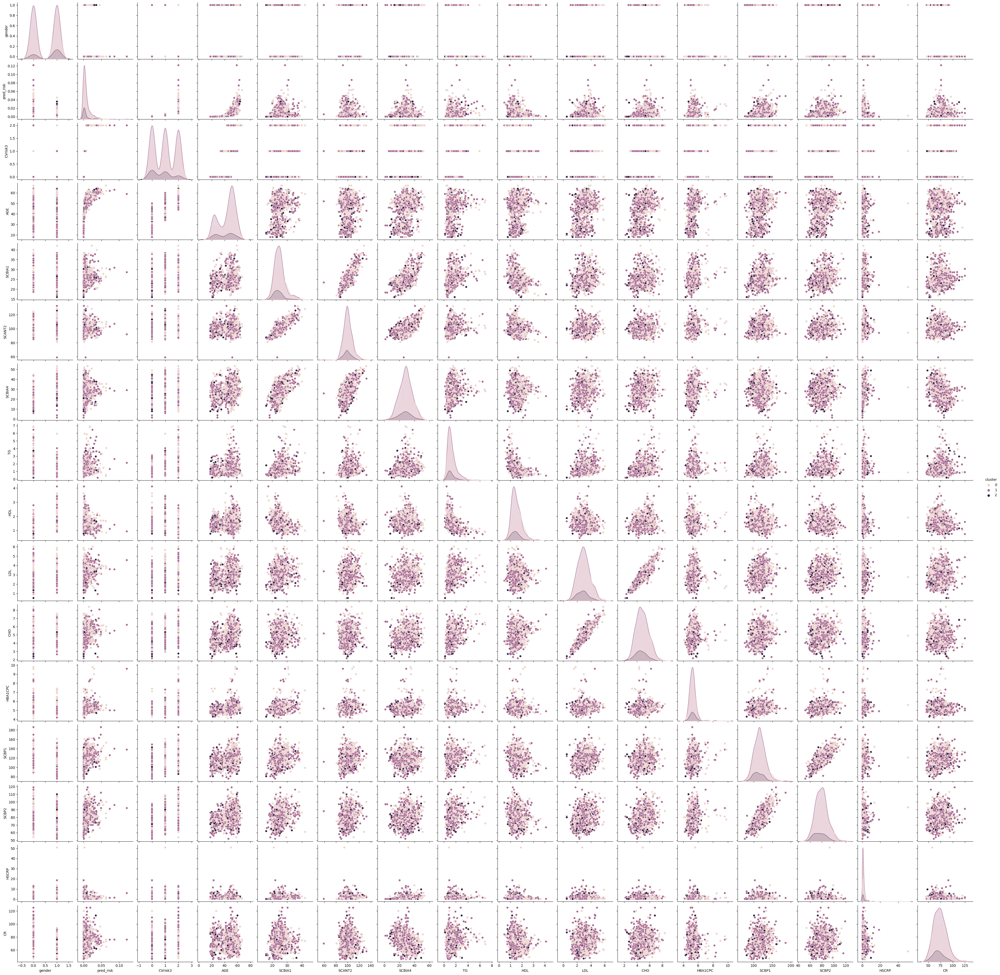

In [47]:
# Featsel + PCA - Agglo., K = 3
samples['cluster'] = list(cluster_labels_df.loc[11,0:])
sns.pairplot(samples.iloc[:,3:], hue='cluster')
plt.show()

None of the cluster assignments seem to inform any of the health indicators.